# Bob Ross Paintings : Two Clustering Approaches
**VGG16 Pre-trained neural network (Convolutional Neural Network) vs clustering using color alone**

## Import Modules
Before we get started, we need to import the modules needed in order to load/process the images along with the modules to extract and cluster our feature vectors.

 - load_img allows us to load an image from a file as a PIL object
 - img_to_array allows us to convert the PIL object into a NumPy array
 - preproccess_input is meant to prepare your image into the format the model requires. You should load images with the Keras load_img function so that you guarantee the images you load are compatible with the preprocess_input function.
 - VGG16 is the pre-trained model we’re going to use
 - KMeans the clustering algorithm we’re going to use
 - PCA for reducing the dimensions of our feature vector

In [1]:
# for loading/processing the images  
from keras.preprocessing.image import load_img 
from keras.preprocessing.image import img_to_array 
from keras.applications.vgg16 import preprocess_input 

# models 
from keras.applications.vgg16 import VGG16 
from keras.models import Model

# clustering and dimension reduction
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# for everything else
import os
import glob
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import pickle
from tqdm import tqdm
from PIL import Image as pilImage
from IPython.display import Image, display
from collections import Counter
import plotly as plotly


## Clone the git repository
This repo stores data from the paintings of Bob Ross featured in the TV Show 'The Joy of Painting'. I will primarily focus on working with the png versions of the final paintings for each episode. https://github.com/jwilber/Bob_Ross_Paintings

In [2]:
# clone the repo to access the bob ross painting data
# !git clone git@github.com:jwilber/Bob_Ross_Paintings.git /Users/caitlynvanheest/projects/bobross

## Load the Images

In [3]:
# use glob.glob to get a list of all the png filenames for the paintings
files = glob.glob('../data/paintings/*.png',recursive = True)

# paintings holds all the image filenames
paintings = [os.path.basename(i) for i in files]

# look at the firts 10 painting names
print(paintings[:10])

['painting263.png', 'painting277.png', 'painting288.png', 'painting129.png', 'painting115.png', 'painting101.png', 'painting32.png', 'painting317.png', 'painting303.png', 'painting302.png']


# VGG16 Model : Visual Similarity
**Use a pre-trained neural network for feature extraction and cluster images using K-means.**

Reference: https://towardsdatascience.com/how-to-cluster-images-based-on-visual-similarity-cd6e7209fe34

VGG16 – Convolutional Network for Classification and Detection

VGG16 is a convolutional neural network model proposed by K. Simonyan and A. Zisserman from the University of Oxford in the paper “Very Deep Convolutional Networks for Large-Scale Image Recognition”. The model achieves 92.7% top-5 test accuracy in ImageNet, which is a dataset of over 14 million images belonging to 1000 classes.

Unfortunately, there are two major drawbacks with VGGNet:

 - It is painfully slow to train.
 - The network architecture weights themselves are quite large (concerning disk/bandwidth).

Due to its depth and number of fully-connected nodes, VGG16 is over 533MB. This makes deploying VGG a tiresome task.VGG16 is used in many deep learning image classification problems; however, smaller network architectures are often more desirable (such as SqueezeNet, GoogLeNet, etc.). But it is a great building block for learning purpose as it is easy to implement.

## Preprocess Images to Meet Model Requirements

**When loading the images we are going to set the target size to (224, 224) because the VGG model expects the images it receives to be 224x224 NumPy arrays.**

Currently, our array has only 3 dimensions (rows, columns, channels) and the model operates in batches of samples. So we need to expand our array to add the dimension that will let the model know how many images we are giving it (num_of_samples, rows, columns, channels).


 - Number of dimensions: 4 
 - Number of images (batch size): 1 
 - Number of rows (0th axis): 224 
 - Number of columns (1st axis): 224 
 - Number of channels (rgb): 3

In [4]:
# load the image as a 224x224 array
img = load_img(files[0], target_size=(224,224))
# convert from 'PIL.Image.Image' to numpy array
img = np.array(img)

reshaped_img = img.reshape(1,224,224,3)
# print(reshaped_img.shape)

In [5]:
# pass the reshaped array to the preprocess_input method and our image is ready to be loaded into the model
x = preprocess_input(reshaped_img)

## Model VGG16

In [6]:
# load model
model = VGG16()
# remove the output layer
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)

In [7]:
features = model.predict(x)
print(features.shape)

(1, 4096)


## Create a Function to Load, Process, and Model each painting

Now we can use this feature_extraction function to extract the features from all of the images and store the features in a dictionary with filename as the keys.

In [8]:
# load the model first and pass as an argument
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

def extract_features(file, model):
    # load the image as a 224x224 array
    img = load_img(file, target_size=(224,224))
    # convert from 'PIL.Image.Image' to numpy array
    img = np.array(img) 
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3) 
    # prepare image for model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)
    return features

In [9]:
data = {}
p = "../data/paintings/painting_features.pkl"

# loop through each image in the dataset
for painting in tqdm(files):
    # try to extract the features and update the dictionary
    try:
        feat = extract_features(painting, model)
        data[painting] = feat
    # if something fails, save the extracted features as a pickle file (optional)
    except:
        with open(p, 'wb') as file:
            pickle.dump(data, file)

# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))
feat.shape

# reshape so that there are 210 samples of 4096 vectors
feat = feat.reshape(-1, 4096)
feat.shape

# get the unique labels (from the painting_labels.csv)
df = pd.read_csv('../data/bob_ross_paintings.csv')
label = df['painting_title'].tolist()
unique_labels = list(set(label))

100%|██████████| 403/403 [02:10<00:00,  3.10it/s]


In [10]:
# get the shape of the feature space
feat.shape

(403, 4096)

## PCA: Dimensionality Reduction
Our feature vector has 4,096 dimensions so it can likely have run time improved if we can reduce the number of dimensions. I can't simply just shorten the list by slicing it or using some subset of it because we will lose information. I will use PCA to reduce the dimensionality while still accounting for ~95% of the explained variance of the model.

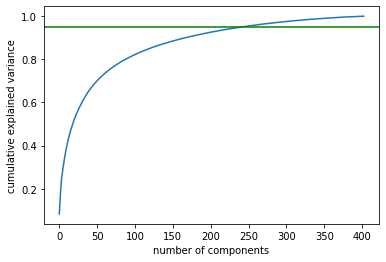

In [11]:
# plot the explained variance by the number of components
# I will use where ~95% of variance is explained as my n_components below
pca = PCA().fit(feat)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
# draw horizontal line marking the .95 explained variance threshold
plt.axhline(y=.95, c='green');

In [12]:
# use np element wise comparison to find the exact n_component where the cumsum >= 0.95
np.sum(np.cumsum(pca.explained_variance_ratio_) <= 0.95)

241

In [13]:
pca = PCA(n_components=241, random_state=22)
pca.fit(feat)
x = pca.transform(feat)

print(f"Features before PCA: {feat.shape[1]}")
print(f"Components after PCA: {pca.n_components}")

Features before PCA: 4096
Components after PCA: 241


## KMeans Clustering
This algorithm will allow us to group our feature vectors into k clusters. Each cluster should contain images that are visually similar. I will use an elbow curve to determine how many clusters (the number of centroids) I want for grouping the paintings.

Plot an elbow curve to identify a suitable k value. When the distortions are plotted and the plot looks like an arm then the “elbow”(the point of inflection on the curve) is the best value of k.

In [14]:
distortions = []
K = range(1, 15)
for k in K:
    kmeanModel = KMeans(n_clusters=k, random_state=22)
    kmeanModel.fit(x)
    distortions.append(kmeanModel.inertia_)

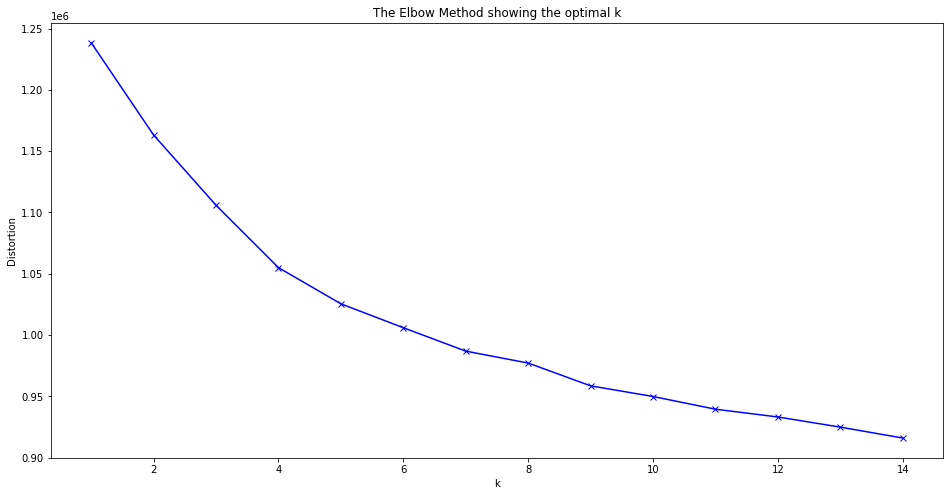

In [15]:
plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

**Based on the above graph, I will proceed with a k value of 6.**

In [16]:
kmeans = KMeans(n_clusters= 6, random_state=22)
kmeans.fit(x)

KMeans(n_clusters=6, random_state=22)

Each label in this list is a cluster identifier for each image in our dataset. The order of the labels is parallel to the list of filenames for each image. This way we can group the images into their clusters.

In [17]:
# holds the cluster id and the images { id: [images] }
clustered_by_content = {}
for file, cluster in zip(filenames,kmeans.labels_):
    if cluster not in clustered_by_content.keys():
        clustered_by_content[cluster] = []
        clustered_by_content[cluster].append(file)
    else:
        clustered_by_content[cluster].append(file)

## Evaluate the Clusters based on Visual Similarity

In [18]:
# Define a function that will allow us to evaluate the loaded pngs for each cluster
def get_paintings(group_name):
    
    group_counts = Counter(kmeans.labels_)
    
    for idx, i in enumerate(group_name, start = 0):
        
        print('These are the {a} paintings in cluster {b}'.format(a = group_counts[idx], b  = idx))
        
        fig = plt.figure(figsize=(20, 160))
        columns = 5
        rows = np.ceil(len(group_name[idx]))

        for x, image in enumerate(group_name[idx]):
            img = plt.imread(image)
            fig.add_subplot(rows, columns, x+1)
            plt.imshow(img)
    
        for ax in fig.axes:
            ax.axis("off") 
            
        plt.show()

These are the 131 paintings in cluster 0


<ipython-input-18-e6275837f949>:16: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  fig.add_subplot(rows, columns, x+1)


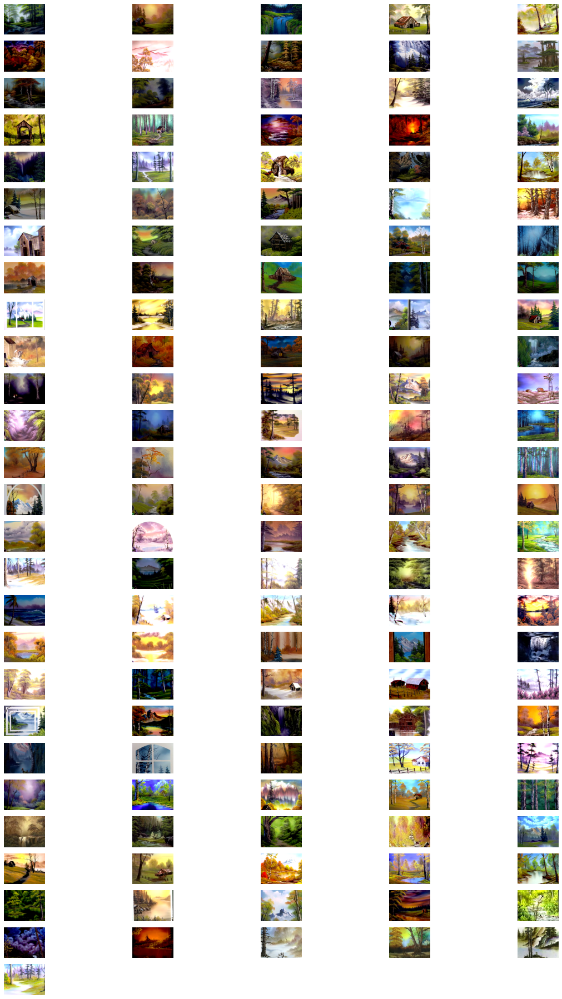

These are the 56 paintings in cluster 1


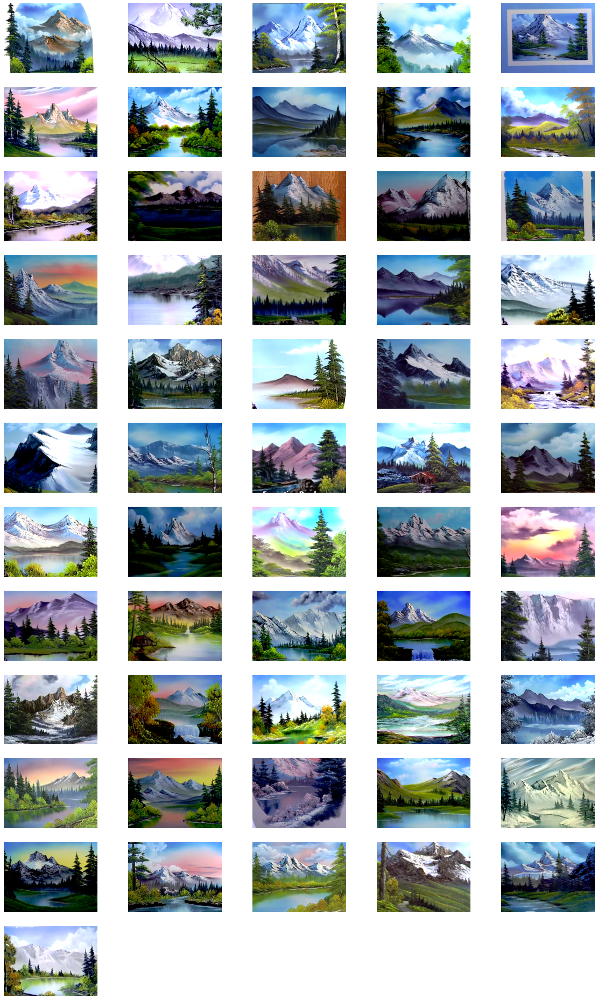

These are the 45 paintings in cluster 2


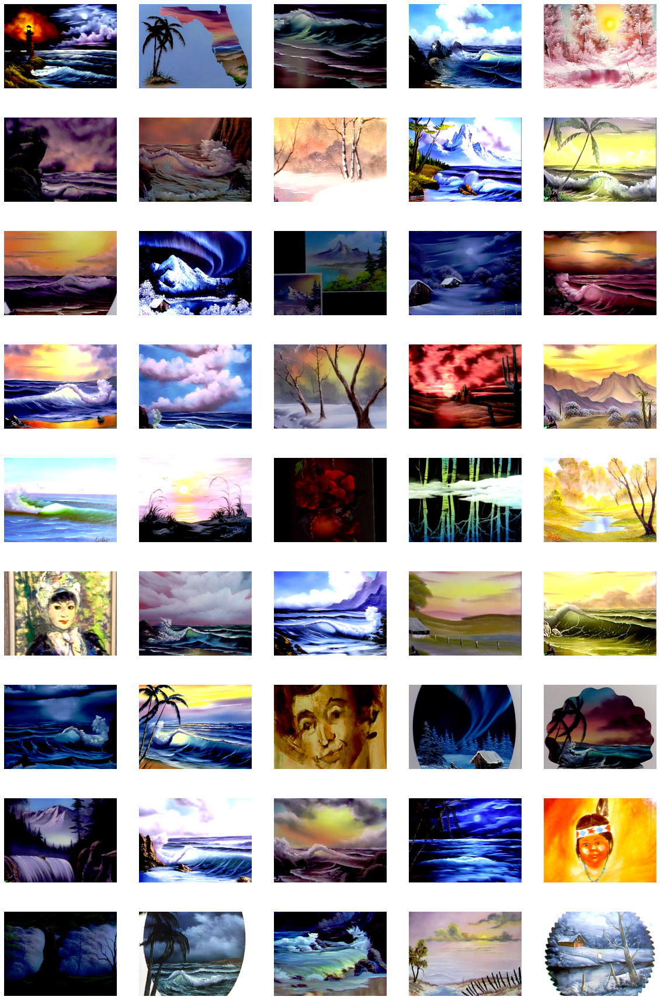

These are the 51 paintings in cluster 3


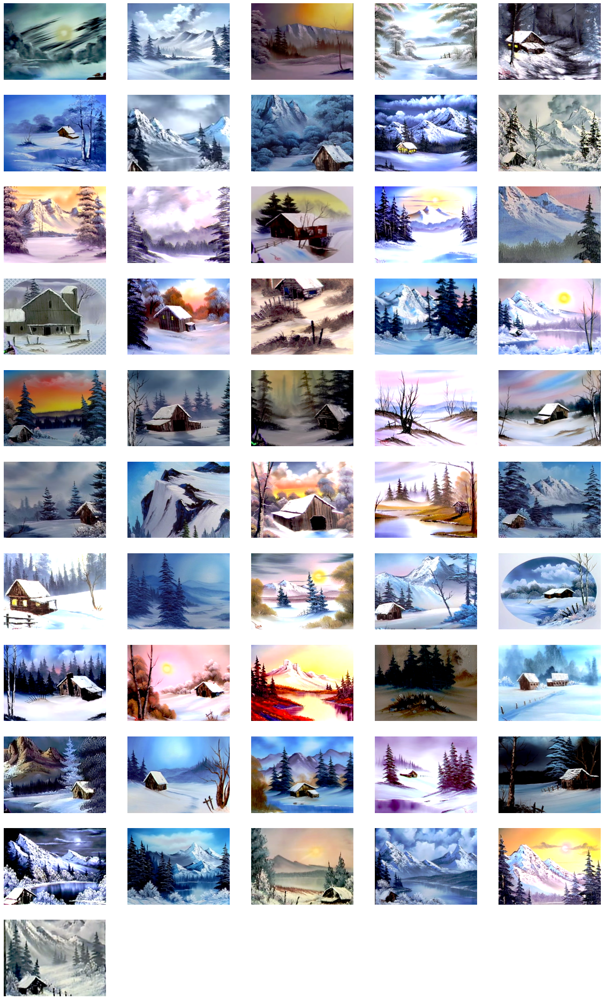

These are the 40 paintings in cluster 4


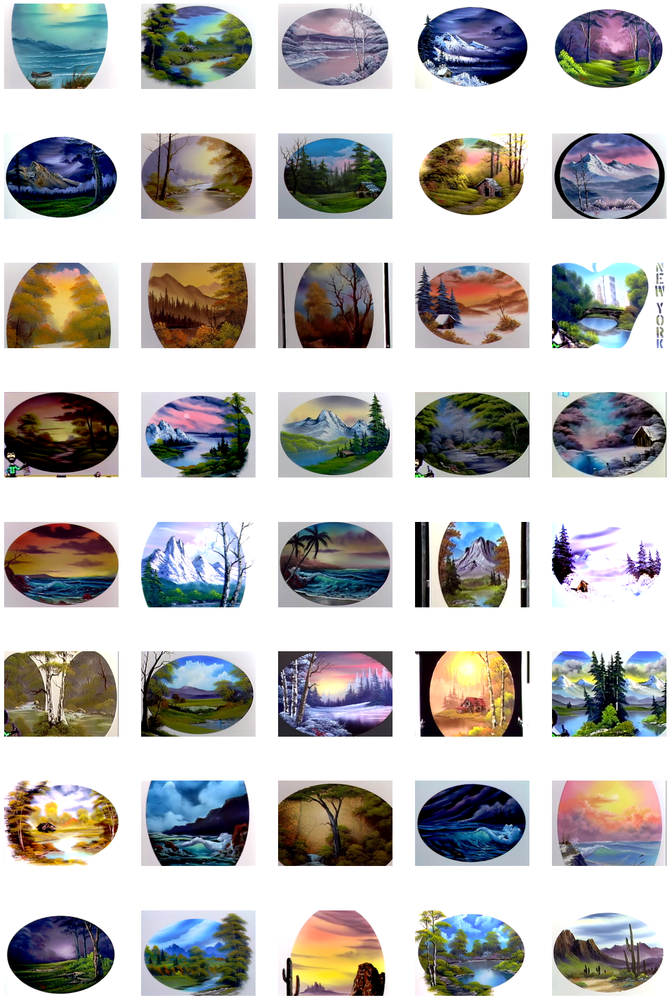

These are the 80 paintings in cluster 5


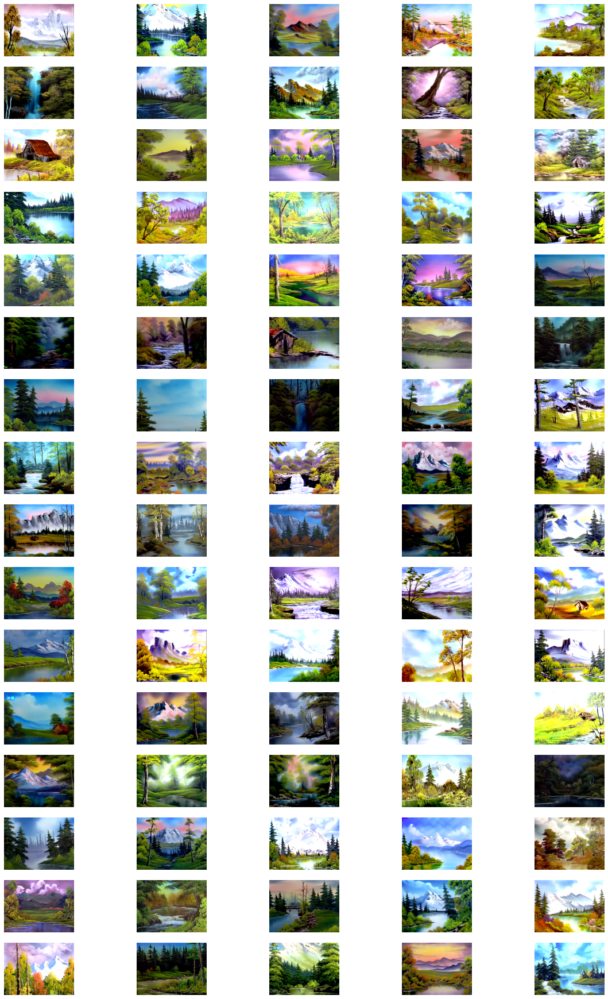

In [19]:
get_paintings(clustered_by_content)

# Clustering on RGB Color

## Preprocess the Images to get Color Frequencies

I want to load each photo in the 224x224 format used in VGG16 model for consistency and then create a dictionary with counts of the RGB tuples in each painting.

In [20]:
# create a list to store the dictionaries in for each painting
img_color_dict = []

# loop through the paintings and load and resize them
# use the Counter object to get the number of occurrences of each RGB tuple
for i in tqdm(files):
    img = load_img(i, target_size=(224,224))
    img_color_dict.append(dict(Counter(pilImage.Image.getdata(img))))
    
# build a pandas dataframe from the list of dictionaries
rgb_df = pd.DataFrame(img_color_dict)

100%|██████████| 403/403 [00:09<00:00, 44.03it/s]


In order to reduce our feature space while accounting or a wide range of colors, I will extract every single color from all the images into one place and cluster those unique colors into groups. Then, I will take that grouping, and use it to rewrite the dataframe where each row is an image but the only fields are the groups of colors (n_clusters) and the values represent the number of pixels in that image that fell into any color in each group.

## KMeans on Unqiue RGB Colors

In [21]:
unique_pixels = {}

for dictionary in img_color_dict:
    unique_pixels.update(dictionary)

unique_colors = list(unique_pixels.keys())

In [22]:
distortions = []
K = range(1, 30)
for k in tqdm(K):
    kmeanModel = KMeans(n_clusters=k, random_state=22)
    kmeanModel.fit(unique_colors)
    distortions.append(kmeanModel.inertia_)

100%|██████████| 29/29 [26:26<00:00, 54.69s/it] 


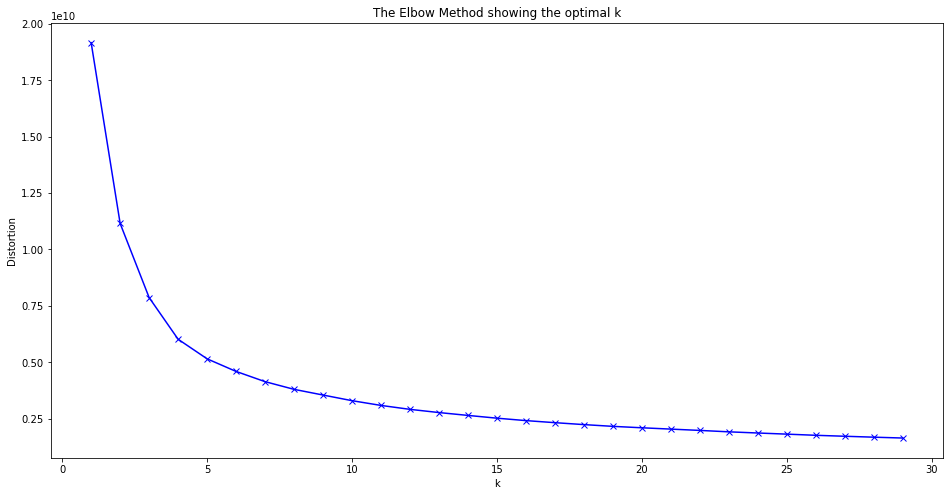

In [23]:
plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [24]:
# based on the elbow curve above, I will proceed with 7 clusters of color
kmeans = KMeans(n_clusters= 10, random_state=22)
kmeans.fit(unique_colors)

KMeans(n_clusters=10, random_state=22)

In [25]:
# create a pd df to aggregate the r,g,b values with the assigned clusters
narrow_colors = pd.DataFrame()

narrow_colors['color_tuple'] = unique_colors
narrow_colors['color_str'] = narrow_colors['color_tuple'].apply(lambda x: 'rgb' + str(x))
narrow_colors['cluster_id'] = list(kmeans.labels_)
narrow_colors['mean_rgb'] = np.mean(np.array(unique_colors), axis = 1)

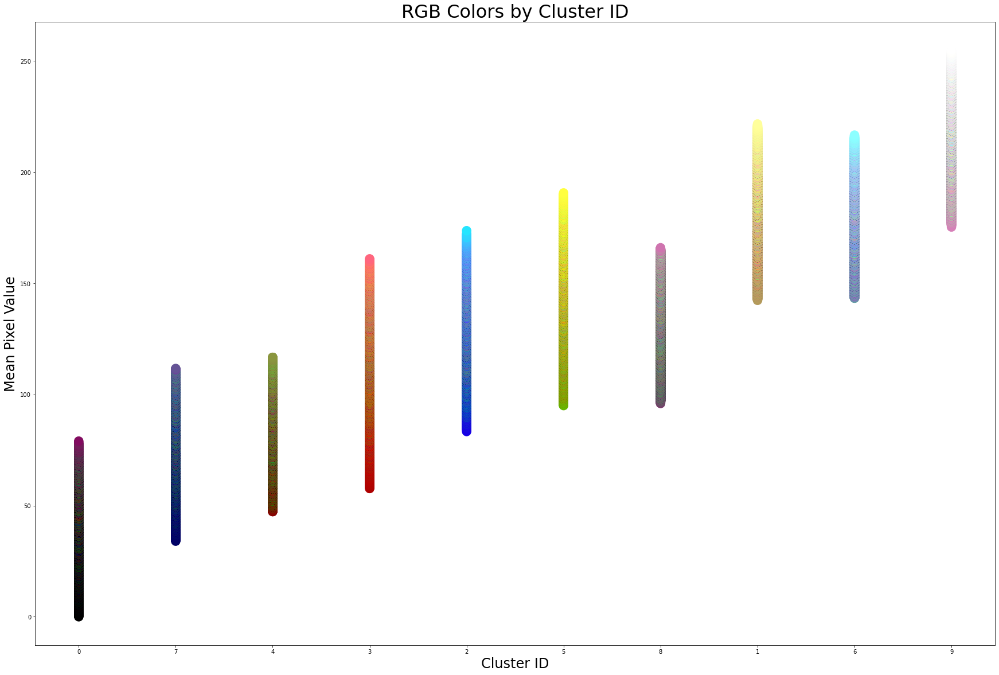

In [26]:
fig = plt.figure(figsize=(30, 20))
ax = fig.add_subplot(111)

portion = len(narrow_colors)

df = narrow_colors.iloc[:portion, :].copy()

df['color_labels'] = [
    plotly.colors.unconvert_from_RGB_255(x) for x in unique_colors[:portion]
]

df = df.sort_values(by='mean_rgb', ascending=True)
df['cluster_id_str'] = df['cluster_id'].astype(str)
plt.title('RGB Colors by Cluster ID', fontsize=32)
plt.xlabel('Cluster ID', fontsize=24)
plt.ylabel('Mean Pixel Value', fontsize=24)
ax.scatter(df.cluster_id_str,
           df.mean_rgb,
           color=df.color_labels[:portion],
           marker="o",
           s=240)
plt.show()

## Color Based Dimensionality Reduction

In [27]:
# transpose the rgb df so we can join the rgb values to the clusters identified above
transposed = rgb_df.copy().transpose().reset_index()

In [28]:
# merge the clusterrgb tuple pairs from the last section with the full dataset
merged_rgb = transposed.merge(narrow_colors, how = "inner", left_on = 'index', right_on = 'color_tuple')
merged_rgb.drop('mean_rgb', axis = 1, inplace=True)

In [29]:
# calculate the sum of pixel frequencies within each cluster for every png
cluster_rgb_counts = merged_rgb.groupby(['cluster_id']).sum()
reduced_df = cluster_rgb_counts.T

## Clustering of Paintings

In [30]:
distortions = []
K = range(1, 15)
for k in K:
    kmeanModel = KMeans(n_clusters=k, random_state=22)
    kmeanModel.fit(reduced_df)
    distortions.append(kmeanModel.inertia_)

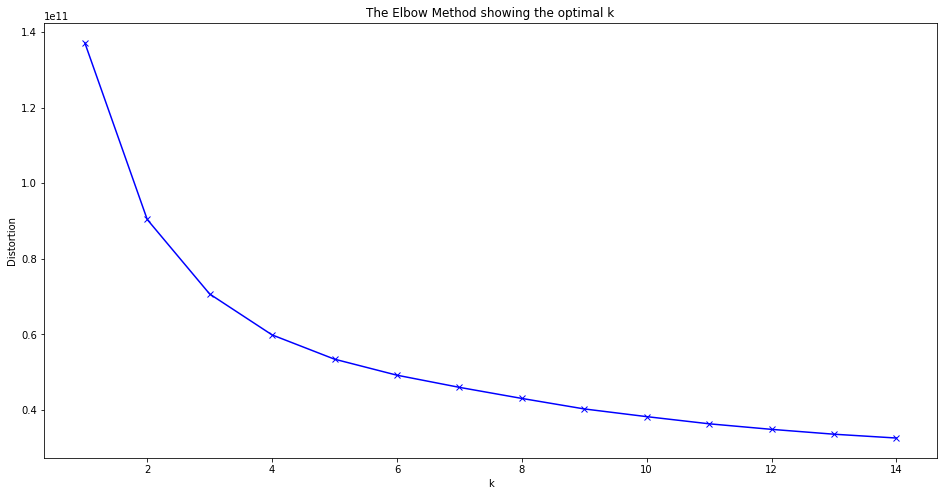

In [31]:
plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [35]:
kmeans = KMeans(n_clusters= 6, random_state=22)
kmeans.fit(reduced_df)

KMeans(n_clusters=6, random_state=22)

In [36]:
# holds the cluster id and the images { id: [images] }
cluster_by_rgb = {}
for file, cluster in zip(filenames,kmeans.labels_):
    if cluster not in cluster_by_rgb.keys():
        cluster_by_rgb[cluster] = []
        cluster_by_rgb[cluster].append(file)
    else:
        cluster_by_rgb[cluster].append(file)

## Visualize the Clusters

These are the 47 paintings in cluster 0


<ipython-input-18-e6275837f949>:16: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  fig.add_subplot(rows, columns, x+1)


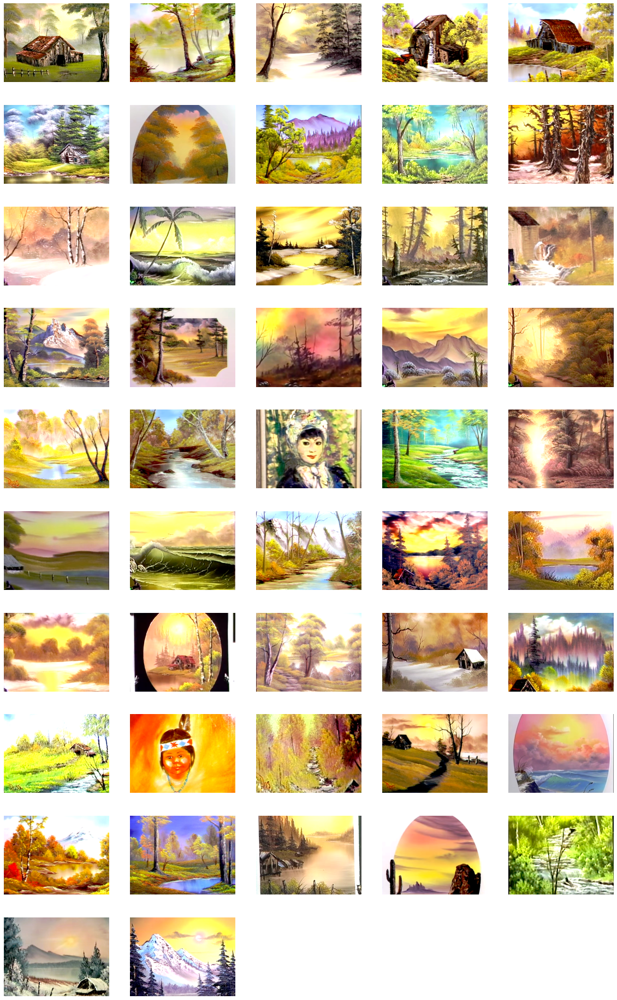

These are the 71 paintings in cluster 1


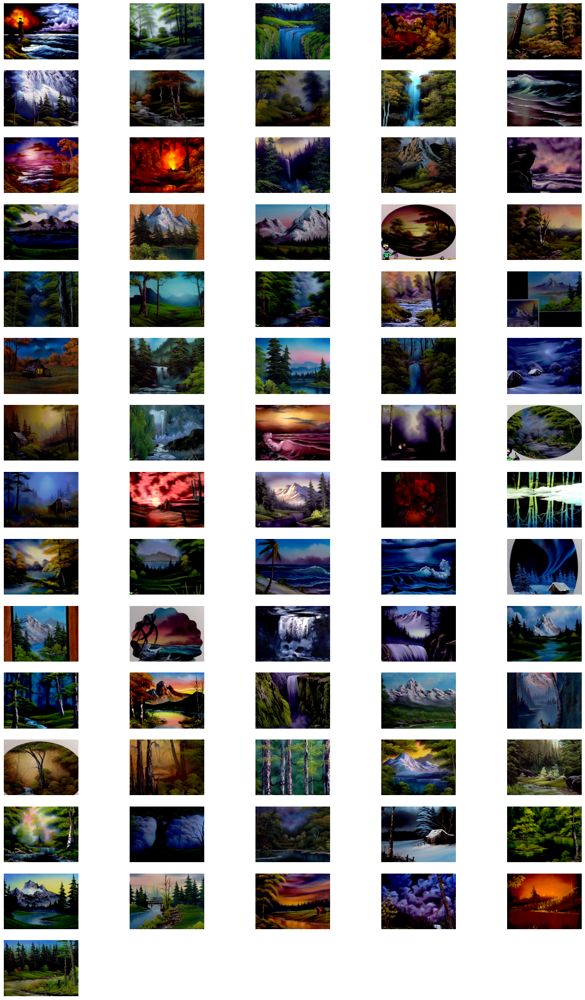

These are the 46 paintings in cluster 2


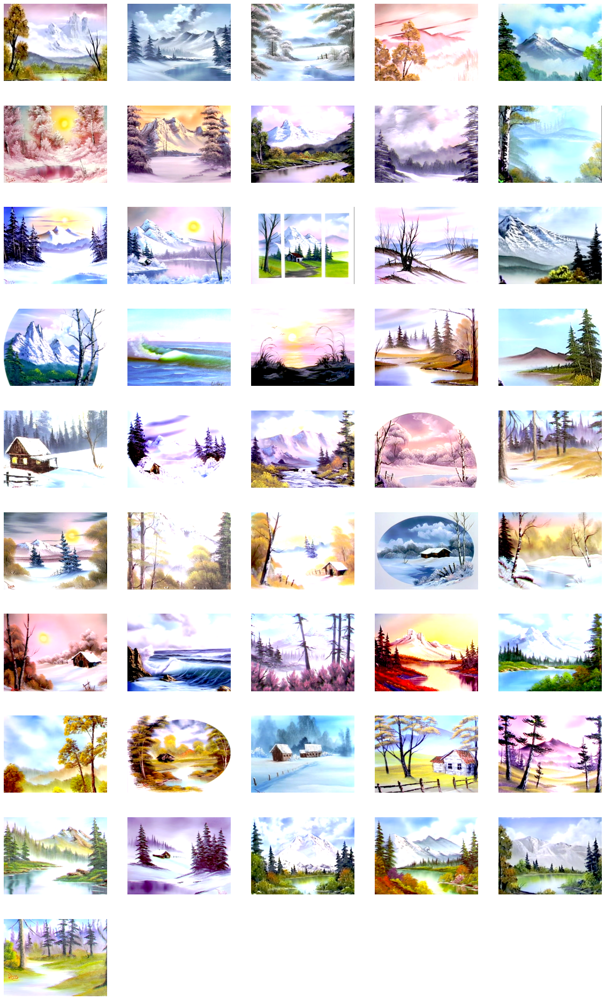

These are the 72 paintings in cluster 3


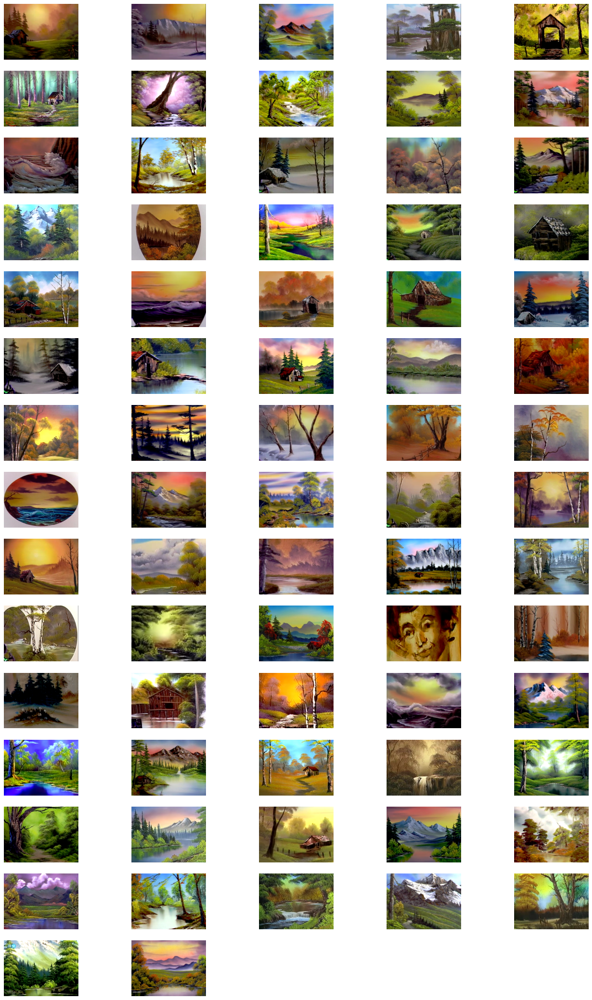

These are the 73 paintings in cluster 4


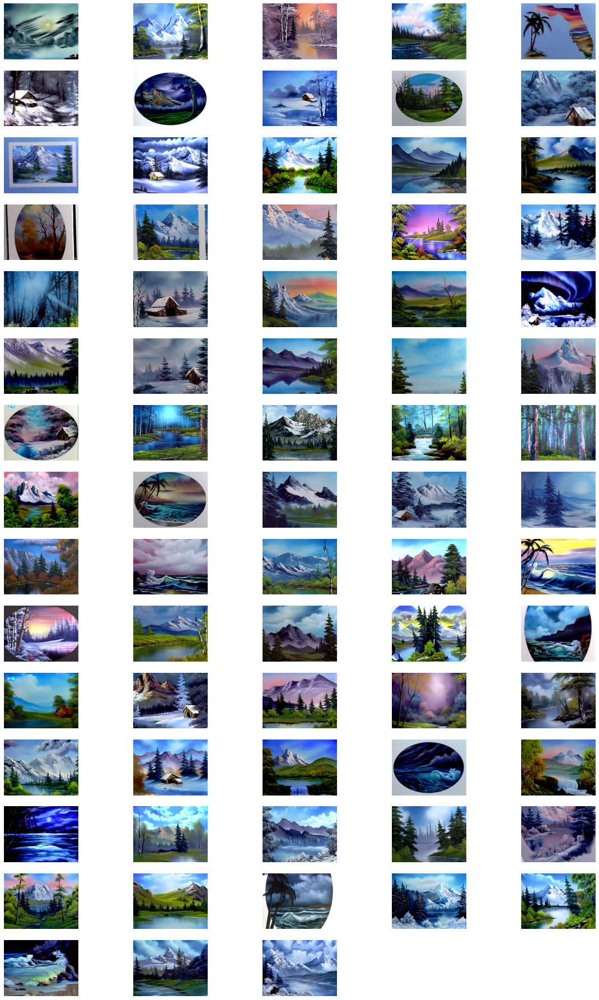

These are the 94 paintings in cluster 5


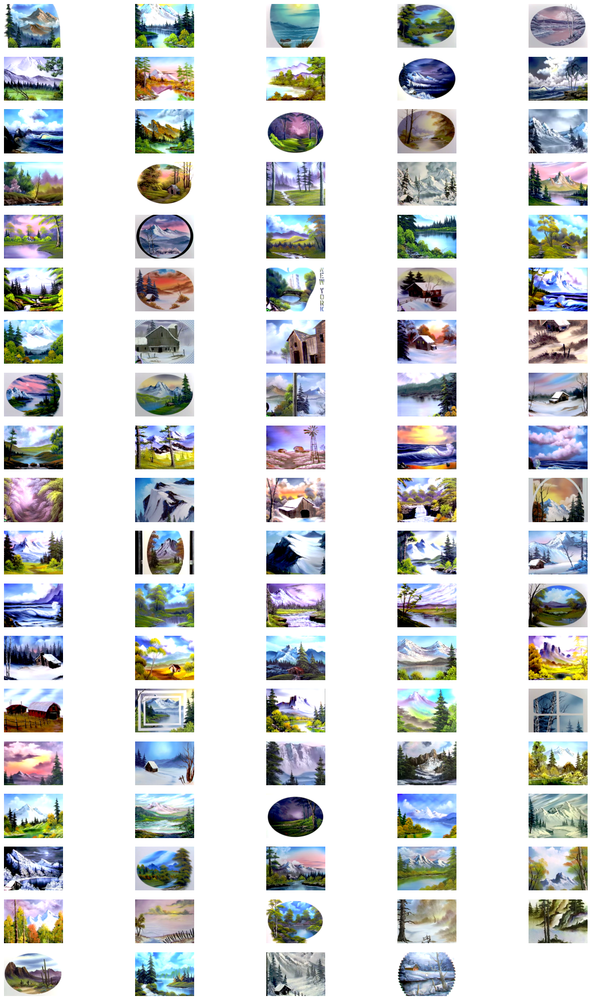

In [37]:
get_paintings(cluster_by_rgb)